## Локальные дескрипторы изображений и построение панорам
##### Автор: [Радослав Нейчев](https://www.linkedin.com/in/radoslav-neychev/), https://t.me/s/girafe_ai

In [2]:
# do not change the code in the block below
# __________start of block__________
import json
import os
import cv2
import random
import glob
import torch

import numpy as np

from skimage import io # for io.imread
from IPython.display import clear_output
from matplotlib import pyplot as plt
from matplotlib import colors # ploting

# __________end of block__________

In [3]:

# do not change the code in the block below
# __________start of block__________
def imshow(images, titles, nrows = 0, ncols=0, figsize = (15,20)):
    """Plot a multiple images with titles.

    Parameters
    ----------
    images : image list
    titles : title list
    ncols : number of columns of subplots wanted in the display
    nrows : number of rows of subplots wanted in the figure
    """

    if ncols == 0 and nrows == 0:
      ncols = len(images)
      nrows = 1
    if ncols == 0:
      ncols = len(images) // nrows
    if nrows == 0:
      nrows = len(images) // ncols

    fig, axeslist = plt.subplots(ncols=ncols, nrows=nrows, squeeze=False, figsize = figsize)
    for i, image in enumerate(images):
        axeslist.ravel()[i].imshow(image, cmap=plt.gray(), vmin=0, vmax=255)
        axeslist.ravel()[i].set_title(titles[i])
        axeslist.ravel()[i].set_axis_off()
    plt.tight_layout() # optional
# __________end of block__________

In [4]:
# do not change the code in the block below
# __________start of block__________
# Create a dictionary to store images with the same prefix
image_dict = {}

# Read all images and group them by prefix
for filename in sorted(glob.glob('./images/*.jpeg')):
    name = os.path.basename(filename)
    prefix = name.split('_')[0]  # Get prefix before first underscore
    
    # Load the image
    img = io.imread(filename)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Add to dictionary
    if prefix in image_dict:
        image_dict[prefix].append((img))
    else:
        image_dict[prefix] = [(img)]
# __________end of block__________

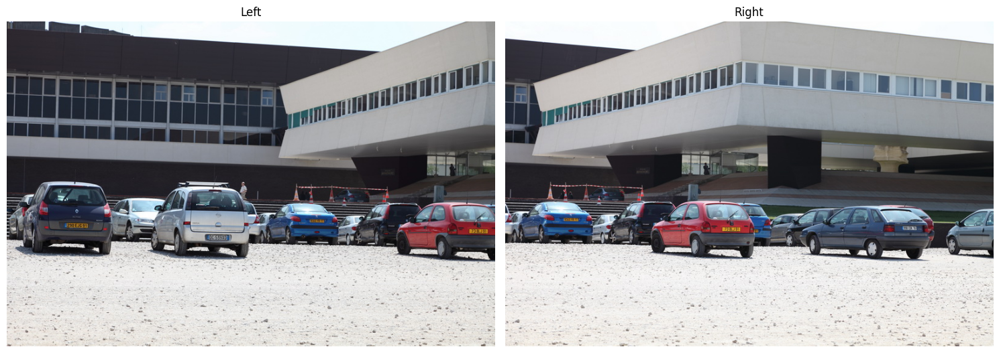

In [5]:
# do not change the code in the block below
# __________start of block__________
url1  = 'https://www.umr-lastig.fr/mathieu-bredif/data/IMG_0045.JPG'
url2  = 'https://www.umr-lastig.fr/mathieu-bredif/data/IMG_0046.JPG'
url2r = 'https://www.umr-lastig.fr/mathieu-bredif/data/IMG_0046r.JPG'
image1  = io.imread( url1 )
image2  = io.imread( url2 )
# image2r = io.imread( url2r )

# image1, image2 = image_dict['example2']
imshow( [image1, image2], ['Left', 'Right'])
# __________end of block__________

#### Шаг 1: Создание панорамы вручную
Подберите сдвиг по координатам X и Y (`tx` и `ty` соответственно) для второго изобаражения относительно первого для задания оптимальной трансляции (смещения) для совмещения изображений вручную. Изображения имеют размеры, приведенные ниже:

In [6]:
print(f"first image shape: {image1.shape}, second image shape: {image2.shape}")

first image shape: (533, 800, 3), second image shape: (533, 800, 3)


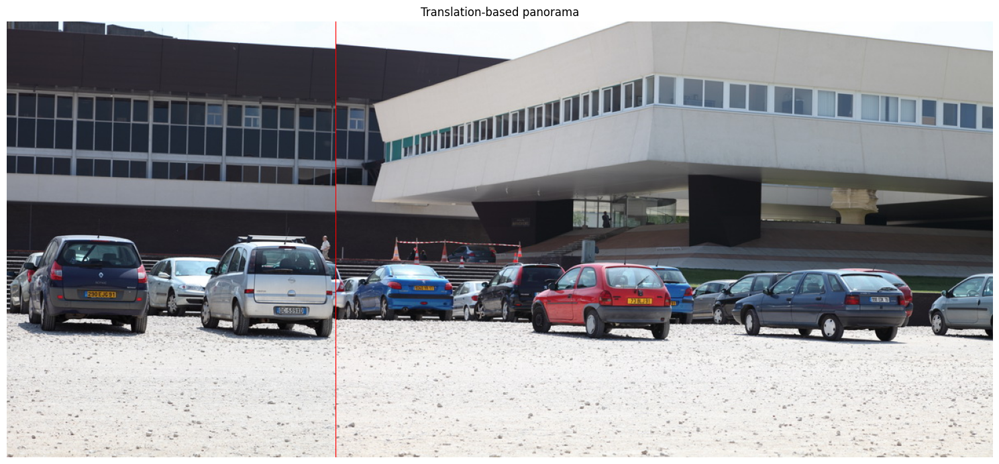

In [7]:
tx = 400
ty = 2
size = (533 - ty, 2 * 800 - tx, 3)
image_trans = np.uint8(np.zeros(size))

# put image 1 on resulting image
image_trans[:, :800, :] = image1[ty:, :, :]

# put image 2 on resulting image
image_trans[:, -800:, :] = image2[:size[0], :, :]

#add vertical line where two images are joined, use red color
image_trans[:, -800, :] = [255, 0, 0]

imshow( [image_trans], ['Translation-based panorama'])

### Часть 1: Обнаружение ключевых точек

Используйте  **SIFT** из OpenCV (`cv2.SIFT_create`) для обнаружения ключевых точек и вычисления их дескрипторов на обоих изображениях.  
Для этого реализуйте функцию `extract_key_points`:

In [8]:
def extract_key_points(img1, img2):
    keypoints_detector = cv2.SIFT_create()
    kpts1, desc1 = keypoints_detector.detectAndCompute(img1, None)
    kpts2, desc2 = keypoints_detector.detectAndCompute(img2, None)
    return kpts1, desc1, kpts2, desc2

kp1, des1, kp2, des2 = extract_key_points(image1, image2)


print("Coordinates of the first keypoint of image1: ", kp1[0].pt)
print("Descriptor of the first keypoint of image1:\n", des1[0])

Coordinates of the first keypoint of image1:  (3.31782603263855, 315.1946105957031)
Descriptor of the first keypoint of image1:
 [  4.   4.   3.  25.  17.  10.  13.  12.  40. 109.   2.   0.   1.   7.
  19.  22. 140. 140.  18.   4.   1.   1.   1.   1.  22.  95.  69.   7.
  21.  10.   1.   1.  23.   0.   0.   0.   2.  14.  13.  58.  61.   2.
   0.   0.  58.  48.  31.  64. 140.  22.  16.  15.  60.  12.   1.  16.
  56. 140.  75.  30.  85.  10.   0.   2.  58.   0.   0.   0.   4.  14.
  19.  94.  69.   1.   1.   4. 140.  49.  13.  60. 140.   6.   1.   3.
 106.   9.   0.   8. 114.  22.   1.   4. 140.  10.   0.   2.  16.   0.
   0.   0.   2.   2.   1.  10.  12.   0.   0.   2.  38.   3.   1.   5.
  44.   2.   0.   1.  16.   0.   0.   0.  17.   0.   0.   1.  27.   0.
   0.   0.]


In [9]:
with open('keypoints_sift.json', 'w') as f:
    json.dump({
        'keypoints1': [list(kp.pt) for kp in kp1[:10]],
        'descriptors1': des1[:10].tolist(),
        'keypoints2': [list(kp.pt) for kp in kp2[:10]],
        'descriptors2': des2[:10].tolist()
    }, f)


In [10]:

# do not change the code in the block below
# __________start of block__________
with open('keypoints_sift.json', 'r') as f:
    loaded_data = json.load(f)

for kp, loaded_kp in zip(kp1[:10], loaded_data['keypoints1']):
    assert np.allclose(kp.pt, loaded_kp, atol=1e-5), f"keypoint {kp.pt} and {loaded_kp} are not close"
# __________end of block__________

### Часть 2: Сопоставление ключевых точек  
Далее необходимо сопоставить признаки между изображениями. Существует множество стратегий сопоставления, давайте используем самый простой подход, реализованный в [BFMatcher](https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_feature2d/py_matcher/py_matcher.html) (от Brute Force).

Оценить качество сопоставления ключевых точек можно на основе аттрибута `distance`. Полезно отсортировать соответствия по возрастанию расстояния, чтобы первые элементы списка были наиболее релевантными.

686


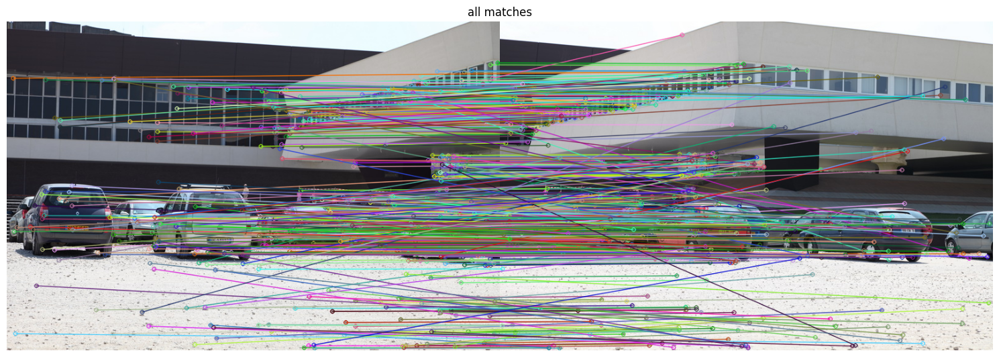

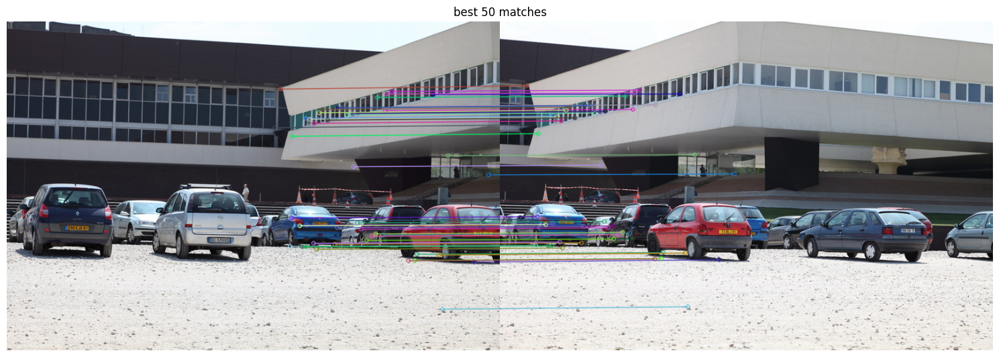

In [11]:
def match_key_points_cv(des1, des2):
    bf =  cv2.BFMatcher(crossCheck=True)
    matches = bf.match(des1, des2)

    sorted_matches = sorted(matches, key = lambda x:x.distance)
    return sorted_matches

def showMatches(img1, kp1, img2, kp2, matches, name):
    img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    imshow([img],[name])

matches_cv = match_key_points_cv(des1, des2)

print(len(matches_cv))
showMatches(image1,kp1,image2,kp2,matches_cv,"all matches")
showMatches(image1,kp1,image2,kp2,matches_cv[:50],"best 50 matches")

Ваша задача: реализовать аналог `BFMatcher`, используя чистый `numpy`. Он основан на подсчете разницы между дескрипторами изображений и вычисляется следующим образом:

1. Подсчет матрицы попарных расстояний между дескрипторами обоих изображений.
2. Для каждого дескриптора изображения 1 находится наиболее похожий (ближайший) дескриптор изображения 2.
2. Для каждого дескриптора изображения 2 находится наиболее похожий (ближайший) дескриптор изображения 1.
4. Те пары дескрипторов, которые совпали (т.е. дескрипторы ближайшие друг для друга) считаются парами.

Шаблоны кода написаны ниже. 

In [12]:

# do not change the code in the block below
# __________start of block__________
class DummyMatch:
    def __init__(self, queryIdx, trainIdx, distance):
        self.queryIdx = queryIdx  # index in des1
        self.trainIdx = trainIdx  # index in des2
        self.distance = distance
# __________end of block__________


def l2_distance_matrix(des1: np.ndarray, des2: np.ndarray) -> np.ndarray:
    """
    Args:
        des1 (np.ndarray): Descriptors from image 1, shape (N1, D)
        des2 (np.ndarray): Descriptors from image 2, shape (N2, D)

    Returns:
        np.ndarray: pairwise distances between des1 and des2 points, shape (N1, N2)

    Compute pairwise L2 distance between two descriptor matrices.
    """
    d1_sq = np.sum(des1 ** 2, axis=1, keepdims=True)
    d2_sq = np.sum(des2 ** 2, axis=1, keepdims=True).T
    return np.sqrt(d1_sq + d2_sq - 2 * np.dot(des1, des2.T))

def match_key_points_numpy(des1: np.ndarray, des2: np.ndarray) -> list:
    """
    Match descriptors using brute-force matching with cross-check.

    Args:
        des1 (np.ndarray): Descriptors from image 1, shape (N1, D)
        des2 (np.ndarray): Descriptors from image 2, shape (N2, D)

    Returns:
        List[DummyMatch]: Sorted list of mutual best matches.
    """
    distances = l2_distance_matrix(des1, des2)  # shape (N1, N2)

    # For each descriptor in des1, find best match in des2
    best_in_des2 = np.argmin(distances, axis=1)  # shape (N1,)
    # For each descriptor in des2, find best match in des1
    best_in_des1 = np.argmin(distances, axis=0)  # shape (N2,)

    matches = []
    for i, j in enumerate(best_in_des2):
        if best_in_des1[j] == i:  # cross-check passed
            distance = distances[i, j]
            matches.append(DummyMatch(queryIdx=i, trainIdx=j, distance=distance))

    # Sort matches by distance (as OpenCV does)
    matches.sort(key=lambda m: m.distance)
    return matches


Проверка:

In [13]:

# do not change the code in the block below
# __________start of block__________
def test_numpy_bf_matcher_equivalence(des1, des2):
    # OpenCV BFMatcher
    cv_matches = match_key_points_cv(des1, des2)
    
    # Our matcher
    np_matches = match_key_points_numpy(des1, des2)

    # Compare match indices and distances
    assert len(cv_matches) == len(np_matches), f"Match count mismatch: {len(cv_matches)} vs {len(np_matches)}"

    for idx, (m_cv, m_np) in enumerate(zip(cv_matches, np_matches)):
        assert m_cv.queryIdx == m_np.queryIdx
        assert m_cv.trainIdx == m_np.trainIdx
        assert abs(m_cv.distance - m_np.distance) < 1e-4, f"Distance mismatch on {idx}th match: {m_cv.distance:.4f} vs {m_np.distance:.4f}"

    print("Your numpy implementation matches OpenCV BFMatcher output!")

test_numpy_bf_matcher_equivalence(des1, des2)
# __________end of block__________

Your numpy implementation matches OpenCV BFMatcher output!


### Шаг 3 (опциональный): Оценка матрицы гомографии с использованием DLT и RANSAC

Функция cv2.findHomography оценивает гомографию, которая преобразует исходные точки в целевые. При использовании метода RANSAC она устойчива к выбросам. Ниже доступна реализация функции с использованием RANSAC, а также с использованием более простого метода DLT.

Ваша опциональная задача: реализовать DLT на чистом `numpy`.

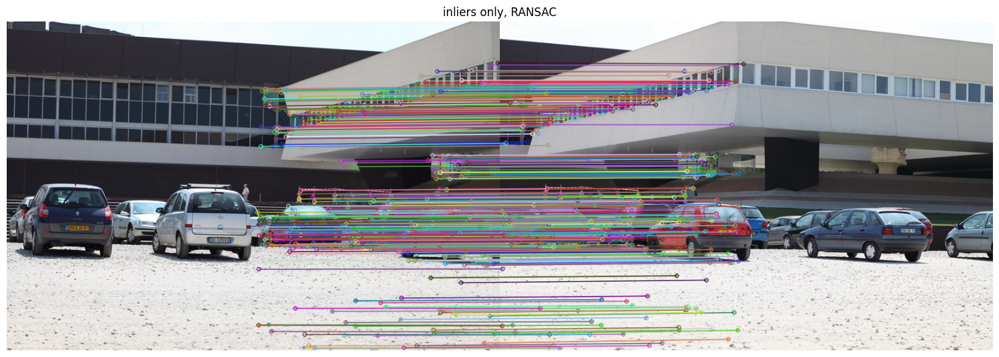

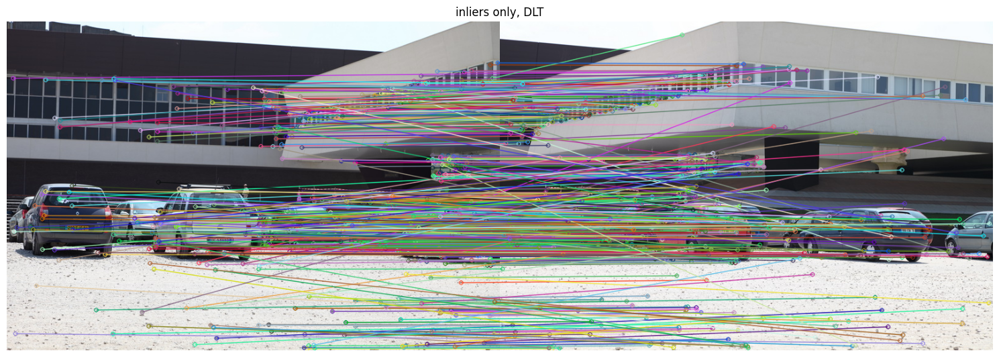

In [14]:

# do not change the code in the block below
# __________start of block__________
def findHomography_dlt_opencv(matches, keypoint1, keypoint2, mode='DLT'):

    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)

    if mode == 'DLT':
        mode = 0
    elif mode == 'RANSAC':
        mode = cv2.RANSAC
    H, mask = cv2.findHomography(src_pts, dst_pts, mode)
    mask = mask.ravel().tolist()

    inliers = []
    for i in range(len(mask)):
      if mask[i] == 1:
        inliers.append(matches[i])

    return H, inliers


H, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'RANSAC')
showMatches(image1,kp1,image2,kp2,inliers,"inliers only, RANSAC")


H, inliers = findHomography_dlt_opencv(matches_cv, kp1, kp2, 'DLT')
showMatches(image1,kp1,image2,kp2,inliers,"inliers only, DLT")

# __________end of block__________

In [15]:
def normalize_points(points: np.ndarray):
    """
    Normalizes 2D points so that centroid is at origin and average distance to origin is sqrt(2).

    Args:
        points (np.ndarray): Array of shape (N, 2)

    Returns:
        Tuple[np.ndarray, np.ndarray]: Normalized points, normalization matrix (3x3)
    """
    mean = np.mean(points, axis=0)
    std = np.std(points, axis=0)
    scale = np.sqrt(2) / (std + 1e-8)

    T = np.array([
        [scale[0], 0, -scale[0] * mean[0]],
        [0, scale[1], -scale[1] * mean[1]],
        [0, 0, 1]
    ])

    points_h = np.hstack([points, np.ones((points.shape[0], 1))])
    normalized = (T @ points_h.T).T[:, :2]

    return normalized, T

def dlt_homography_normalized(pts1: np.ndarray, pts2: np.ndarray) -> np.ndarray:
    """
    Computes homography matrix using normalized Direct Linear Transform (DLT).

    Args:
        pts1 (np.ndarray): Source points (N, 2)
        pts2 (np.ndarray): Destination points (N, 2)

    Returns:
        np.ndarray: Homography matrix (3x3)
    """
    pts1 = pts1.reshape(-1, 2)
    pts2 = pts2.reshape(-1, 2)
    assert pts1.shape == pts2.shape and pts1.shape[0] >= 4

    pts1_norm, T1 = normalize_points(pts1)
    pts2_norm, T2 = normalize_points(pts2)

    A = []
    for (x, y), (xp, yp) in zip(pts1_norm, pts2_norm):
        A.append([-x, -y, -1, 0, 0, 0, x * xp, y * xp, xp])
        A.append([0, 0, 0, -x, -y, -1, x * yp, y * yp, yp])
    A = np.array(A)

    _, _, Vt = np.linalg.svd(A)
    H_norm = Vt[-1].reshape(3, 3)

    # Denormalize
    H = np.linalg.inv(T2) @ H_norm @ T1
    H = H / H[2, 2]

    return H


def findHomography_dlt_numpy(matches, keypoint1, keypoint2):
    src_pts = np.float32([keypoint1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([keypoint2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    print(src_pts.shape, dst_pts.shape)
    return dlt_homography_normalized(src_pts, dst_pts), None




Т.к. DLT неустойчив к выбросам (и вообще достаточно прост), будем использовать `NUM_BEST_MATCHES` лучших совпадений

In [16]:
NUM_BEST_MATCHES = 50

for img1, img2 in [[image1, image2]]:
    kp1, des1, kp2, des2 = extract_key_points(img1, img2)
    matches_cv = match_key_points_cv(des1, des2)

    H_numpy, _ = findHomography_dlt_numpy(matches_cv[:NUM_BEST_MATCHES], kp1, kp2)
    H, _ = findHomography_dlt_opencv(matches_cv[:NUM_BEST_MATCHES], kp1, kp2)
    print(np.allclose(H_numpy, H, atol=4e-1))

(50, 1, 2) (50, 1, 2)
True


In [17]:
H

array([[ 1.08537489e+00, -6.54071361e-03, -4.35631839e+02],
       [ 3.10156584e-02,  1.06524825e+00, -2.15134524e+01],
       [ 1.04322098e-04,  5.12327319e-06,  1.00000000e+00]])

In [18]:
H_numpy

array([[ 1.08481146e+00, -6.44354291e-03, -4.35406766e+02],
       [ 3.07680149e-02,  1.06499690e+00, -2.14005532e+01],
       [ 1.03389261e-04,  5.69750285e-06,  1.00000000e+00]])

In [ ]:
np.allclose(a, H, atol=4e-1)

TypeError: allclose() missing 1 required positional argument: 'b'

In [5]:

# def detect_dog_keypoints(image: np.ndarray, sigma1=1.0, sigma2=2.0, threshold=5) -> np.ndarray:
#     """
#     Detect keypoints using Difference of Gaussians (DoG) and simple local extrema.

#     Args:
#         image (np.ndarray): Grayscale image
#         sigma1 (float): Lower sigma for Gaussian blur
#         sigma2 (float): Higher sigma for Gaussian blur
#         threshold (float): Threshold for DoG extrema magnitude

#     Returns:
#         List of (x, y) keypoints
#     """
#     blur1 = cv2.GaussianBlur(image, (0, 0), sigmaX=sigma1)
#     blur2 = cv2.GaussianBlur(image, (0, 0), sigmaX=sigma2)
#     dog = cv2.subtract(blur1, blur2)

#     # Pad and find local extrema
#     dog_padded = cv2.copyMakeBorder(dog, 1, 1, 1, 1, cv2.BORDER_REFLECT)
#     keypoints = []

#     for y in range(1, dog.shape[0] + 1):
#         for x in range(1, dog.shape[1] + 1):
#             value = dog_padded[y, x]
#             neighborhood = dog_padded[y-1:y+2, x-1:x+2]
#             print(value)
#             if abs(value) > threshold:
#                 if value == np.max(neighborhood) or value == np.min(neighborhood):
#                     keypoints.append((x-1, y-1))  # remove padding offset

#     return keypoints

# def draw_keypoints(image: np.ndarray, keypoints) -> np.ndarray:
#     """
#     Draws keypoints as small red circles on a copy of the input image.

#     Args:
#         image (np.ndarray): Input image (grayscale or color)
#         keypoints (List[Tuple[int, int]]): List of (x, y) coordinates

#     Returns:
#         np.ndarray: Image with keypoints drawn
#     """
#     output = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR) if len(image.shape) == 2 else image.copy()
#     for (x, y) in keypoints:
#         cv2.circle(output, (x, y), radius=2, color=(0, 0, 255), thickness=-1)
#     return output

# # --- Usage example ---
# # Load grayscale image
# img = image_dict['example6'][1]

# # Detect and visualize
# keypoints = detect_dog_keypoints(img, sigma1=1.0, sigma2=2.0, threshold=5)
# img_with_keypoints = draw_keypoints(img, keypoints)

# # Show image
# imshow([img_with_keypoints], [""])
# # cv2.imshow("DoG Keypoints", )


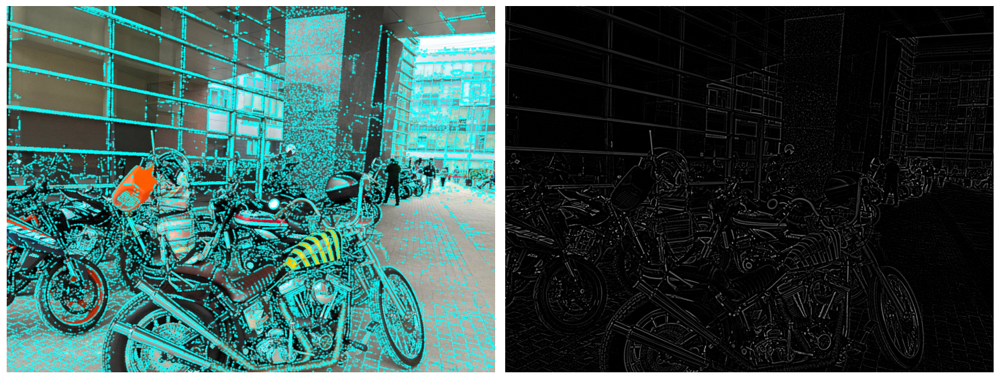

In [7]:
import cv2
import numpy as np
def detect_DoG_keypoints(image, sigma1=1.0, sigma2=2.0, threshold=5):
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image.copy()

    blur1 = cv2.GaussianBlur(gray, (0, 0), sigmaX=sigma1)
    blur2 = cv2.GaussianBlur(gray, (0, 0), sigmaX=sigma2)
    DoG = cv2.subtract(blur1, blur2)

    keypoints = []
    for y in range(1, DoG.shape[0] - 1):
        for x in range(1, DoG.shape[1] - 1):
            val = DoG[y, x]
            if abs(val) > threshold:
                local_patch = DoG[y-1:y+2, x-1:x+2]
                if val == np.max(local_patch) or val == np.min(local_patch):
                    keypoints.append(cv2.KeyPoint(float(x), float(y), 1))  # Fixed here

    return keypoints, DoG


def visualize_keypoints(image, keypoints, color=(0, 255, 255), radius=2, thickness=1):
    image_copy = image.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(image_copy, (x, y), radius, color, thickness, lineType=cv2.LINE_AA)
    return image_copy


image = img = image_dict['example6'][1]
#cv2.imread('your_image.jpg')  # Replace with your path

if image is None:
    raise ValueError("Could not load image. Please check the path.")

# Detect keypoints using DoG
keypoints, dog_img = detect_DoG_keypoints(image)

# Visualize keypoints
result_img = visualize_keypoints(image, keypoints)

# Show results
imshow([result_img, cv2.normalize(dog_img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)], ["", ""])

In [18]:
# def test_dlt_matches_opencv():
#     # Define four corresponding points
#     pts1 = np.array([[0, 0], [1, 0], [1, 1], [0, 1]], dtype=np.float32)
#     pts2 = np.array([[0, 0], [2, 0], [2, 2], [0, 2]], dtype=np.float32)

#     # OpenCV homography (non-robust DLT)
#     H_cv, _ = findHomography_dlt_opencv()

#     # Our implementation
#     H_np = dlt_homography(pts1, pts2)

#     # Normalize both
#     H_cv /= H_cv[2, 2]
#     H_np /= H_np[2, 2]

#     # Check closeness
#     assert np.allclose(H_cv, H_np, atol=1e-5), f"Mismatch:\\nOpenCV:\\n{H_cv}\\nOur DLT:\\n{H_np}"
#     return H_cv, H_np

# # Run test
# test_dlt_matches_opencv()


#### 4. Построение панорамы


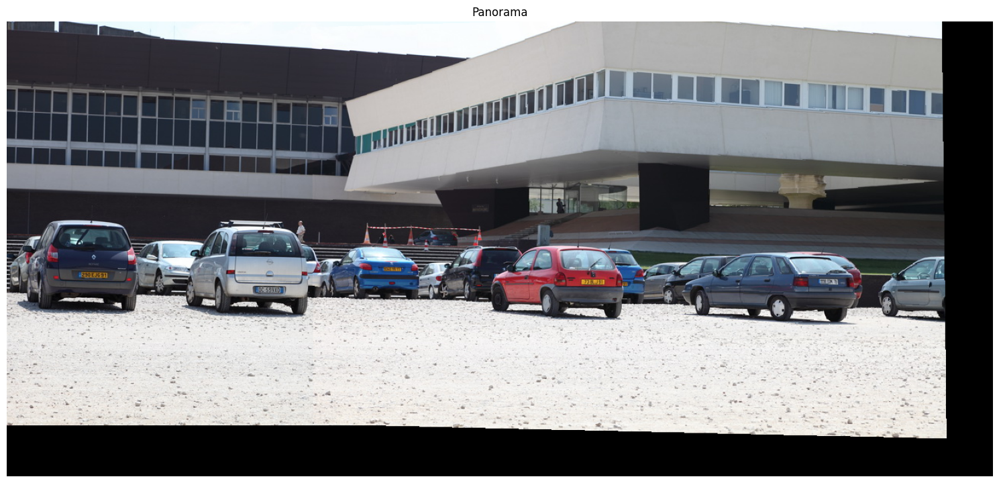

In [19]:
def panorama(img1, img2, H, size):
    img = np.uint8(np.zeros(size))
    img = cv2.warpPerspective(src=img1, dst=img, M=np.eye(3), dsize=(size[1], size[0]))
    img = cv2.warpPerspective(src=img2, dst=img, M=H, dsize=(size[1], size[0]), flags=cv2.WARP_INVERSE_MAP, borderMode=cv2.BORDER_TRANSPARENT)

    return img

size = (600, 1300, 3)

imshow([panorama(image1, image2, a, size)],["Panorama"])

# Part 5: Panorama Pipeline and Rotation invariance
Now put all pieces together and right your first end-to-end computer vision pipeline that takes 2 images, the size of the output panorama and create a stitched panorama of the specified size.

Does it work when the images are rotated so that they are not approximately aligned at first or when their brightness change (eg due to varying sun illumination) ?
Make a panorama with modified images :
- the rotated version IMG_0046r.JPG of image IMG_0046.JPG
- a darkened version of image1 : image1//2
Which part of the pipeline is responsible to make this work despite these modifications ?

For rotated image keypoint matching returns same matches, because it doesn't rely on coordinates. Moreover we can do rotation with our linear transformation, so for our algorithm it doesn't matter if it's was rotated. For a darkened version of our image we have the same key points since we have the same blobs, corners and local maximums. Difference in descriptors changed for every pair of points, so the closest descriptor is the same one.

In [22]:
image_dict['example1'][0].shape

(1280, 960, 3)

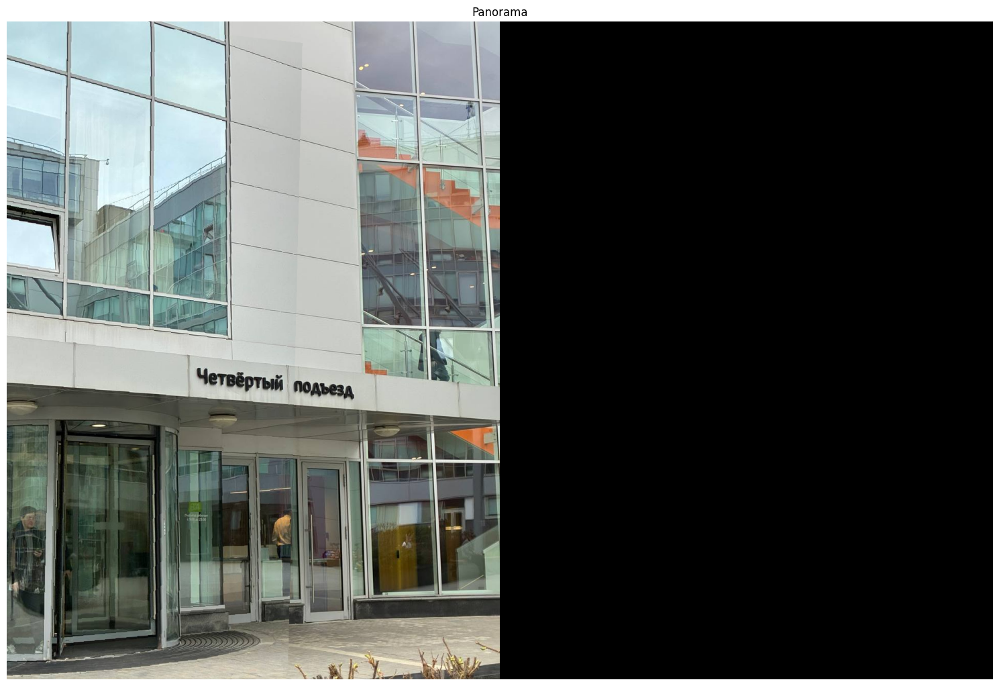

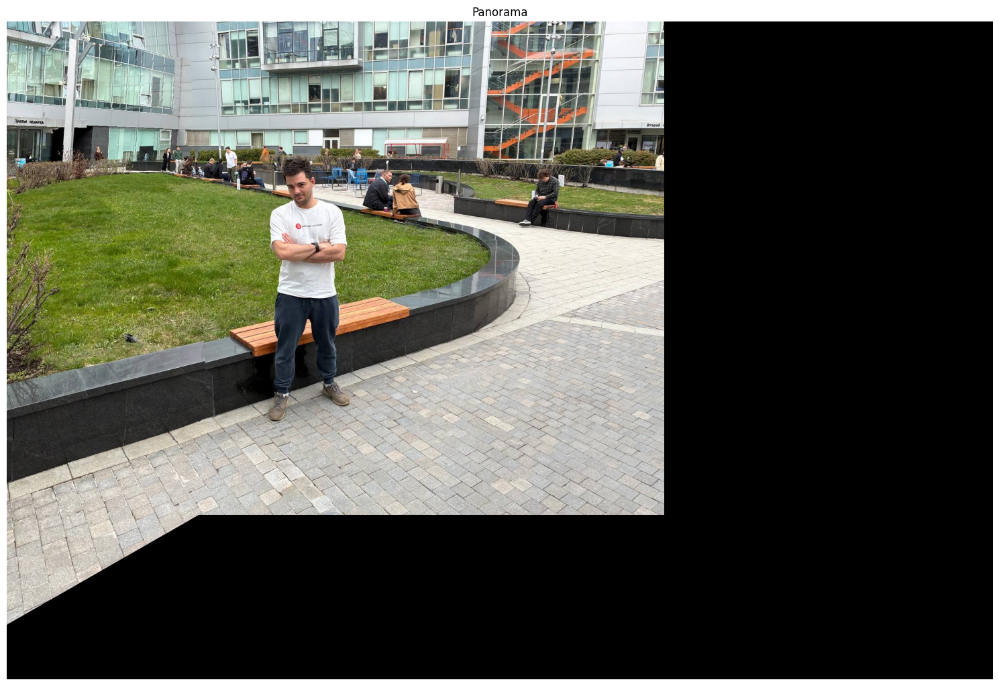

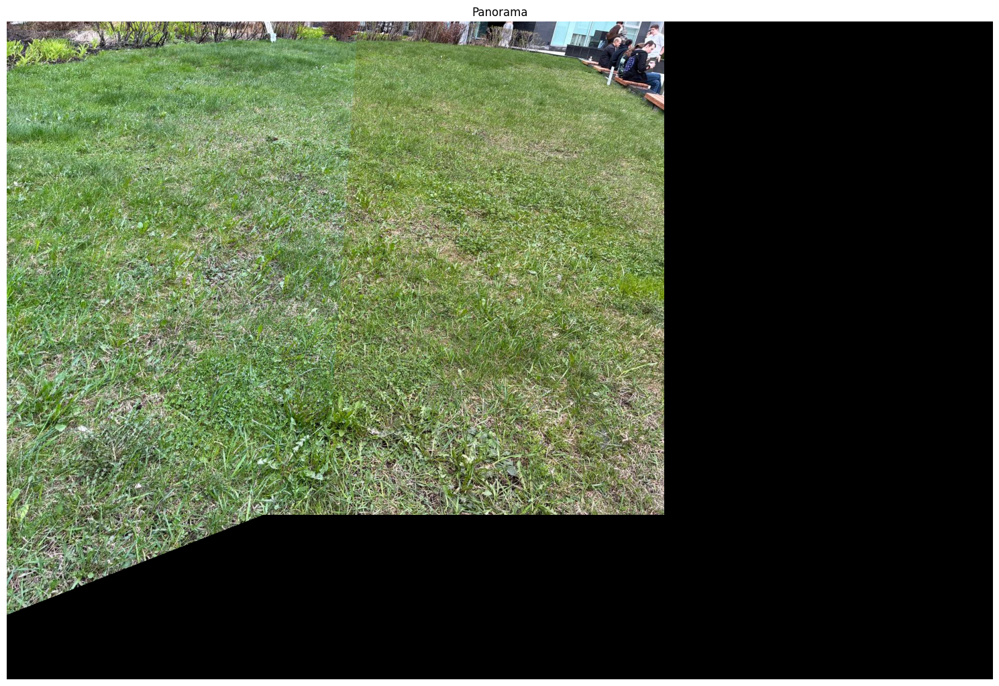

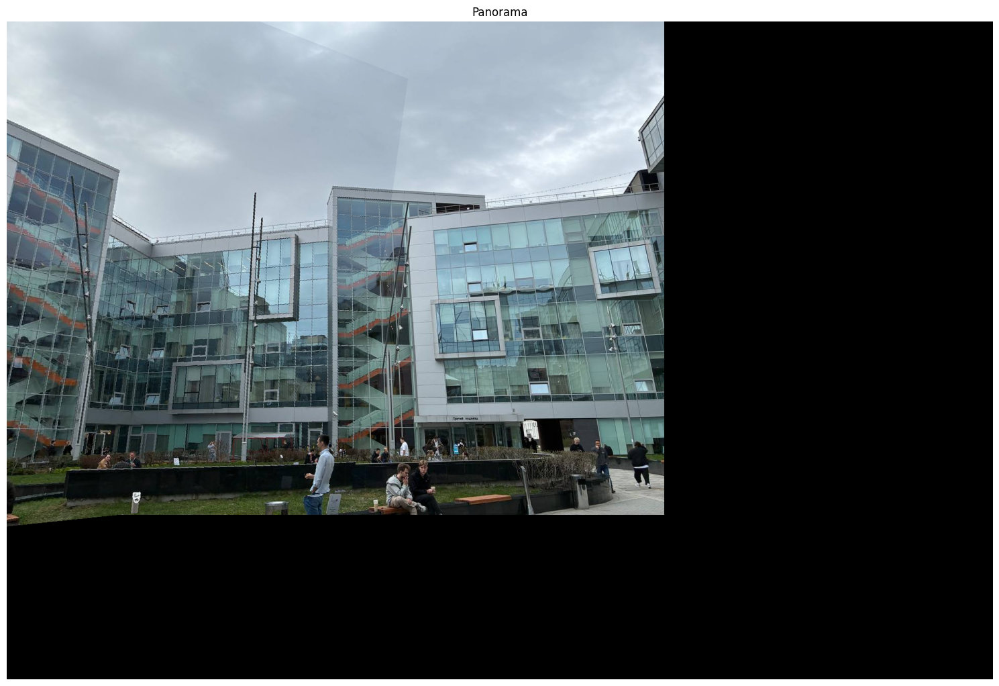

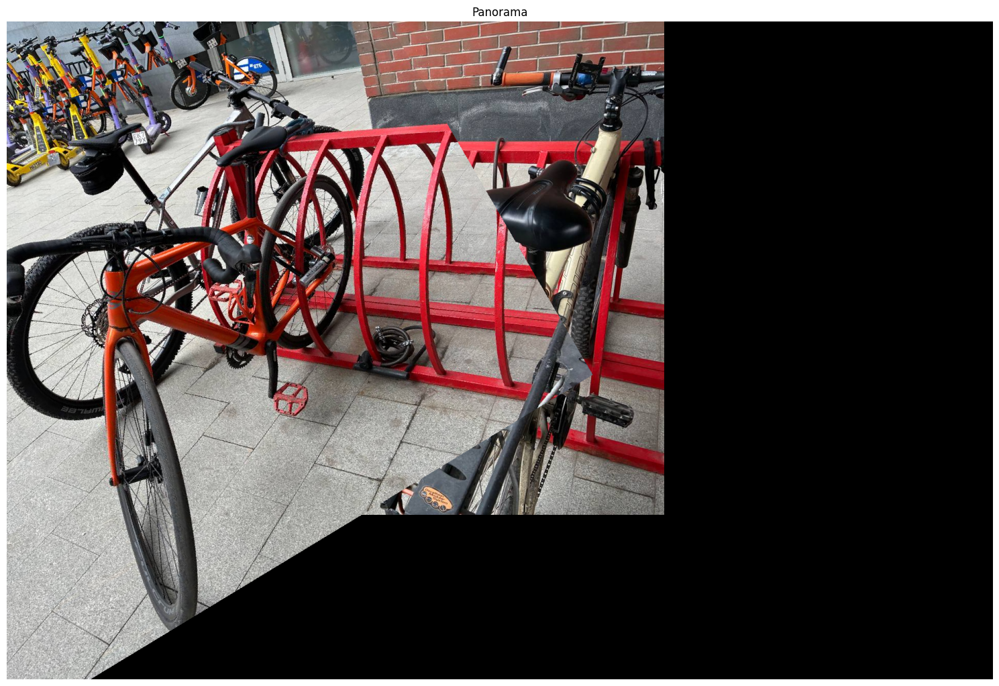

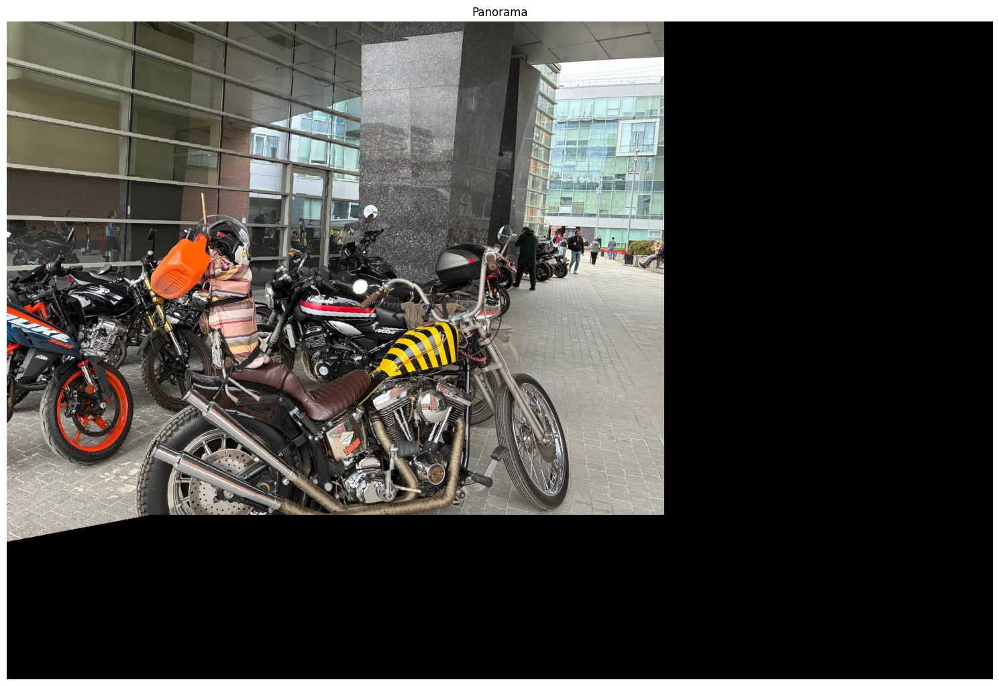

In [23]:
def panorama_pipeline(img1, img2, size):

    kp1, des1, kp2, des2 = extract_key_points(img1, img2)

    matches = match_key_points_cv(des1, des2)

    H, inliers = findHomography_dlt_opencv(matches[:50], kp1, kp2, 'RANSAC')

    res = panorama(img1, img2, H, size)

    return res

size = (1280, 960*2, 3)

for filename, (img1, img2) in image_dict.items():
    imshow([panorama_pipeline(img1, img2, size)],["Panorama"])


Продолжим работать с набором данных [FashionMNIST](https://github.com/zalandoresearch/fashion-mnist).

__Ваша задача: реализовать механизм выделения границ (Sobel filter) и упрощенный вариант построения гистограммы ориентированных градиентов.__

Точность классификации оцениваться не будет, вам лишь необходимо реализовать функции и сдать их в контест.

В ноутбуке присутствует несколько тестов, которые помогут вам отладить свое решение.

In [ ]:
# do not change the code in the block below
# __________start of block__________

train_fmnist_data = FashionMNIST(
    ".", train=True, transform=torchvision.transforms.ToTensor(), download=True
)

train_data_loader = torch.utils.data.DataLoader(
    train_fmnist_data, batch_size=32, shuffle=True, num_workers=2
)

random_batch = next(iter(train_data_loader))
_image, _label = random_batch[0][0], random_batch[1][0]
plt.figure()
plt.imshow(_image.reshape(28, 28))
plt.title(f"Image label: {_label}")
# __________end of block__________

#### Шаг 1. Sobel filtering
Реализуйте функцию `compute_sobel_gradients_two_loops`. Часть функции уже написана, пожалуйста, не меняйте написанный код.

In [3]:
# do not change the code in the block below
# __________start of block__________
import numpy as np
def compute_sobel_gradients_two_loops(image):
    # Get image dimensions
    height, width = image.shape

    # Initialize output gradients
    gradient_x = np.zeros_like(image, dtype=np.float64)
    gradient_y = np.zeros_like(image, dtype=np.float64)

    # Pad the image with zeros to handle borders
    padded_image = np.pad(image, ((1, 1), (1, 1)), mode='constant', constant_values=0)
# __________end of block__________

    # Define the Sobel kernels for X and Y gradients
    sobel_x = None # YOUR CODE HERE
    sobel_y = None # YOUR CODE HERE

    # Apply Sobel filter for X and Y gradients using convolution
    for i in range(1, height + 1):
        for j in range(1, width + 1):
            pass
            # YOUR CODE HERE
    return gradient_x, gradient_y

Для проверки написанного кода мы обратимся к уже реализованной версии в из opencv. Ввиду того, что операция padding'а может произвоиться иначе, будем игнорировать расхождения на краях изображения.

In [4]:
# do not change the code in the block below
# __________start of block__________
def compute_sobel_gradients_opencv(image):
    # Apply Sobel filter for horizontal and vertical gradients
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    
    # Return gradients in both directions
    return sobel_x, sobel_y
# __________end of block__________


In [ ]:
# do not change the code in the block below
# __________start of block__________
image = train_fmnist_data[7][0][0].numpy()
gradients_two_loops = compute_sobel_gradients_two_loops(image)
gradients_opencv = compute_sobel_gradients_opencv(image)

assert np.allclose(gradients_two_loops[0][1:-1, 1:-1], gradients_opencv[0][1:-1, 1:-1], atol=1e-2), "gradients_two_loops[0] and gradients_opencv[0] are not close"
assert np.allclose(gradients_two_loops[1][1:-1, 1:-1], gradients_opencv[1][1:-1, 1:-1], atol=1e-2), "gradients_two_loops[1] and gradients_opencv[1] are not close"
print("Everything seems fine!")
# __________end of block__________


In [ ]:
image = random.choice(train_fmnist_data)[0][0].numpy()
gradients_two_loops = compute_sobel_gradients_two_loops(image)

plt.subplot(1, 3, 1)
plt.imshow(image)
plt.subplot(1, 3, 2)
plt.imshow(gradients_two_loops[0])
plt.subplot(1, 3, 3)
plt.imshow(gradients_two_loops[1])

#### Шаг 2. Подсчет градиентов в полярных координатах.
Реализуйте две функции:
 * `compute_gradient_magnitude`, котрая считает евклидову норму градиента
 * `compute_gradient_direction`, которая счиает его направление в виде угла относительно оси $x$. Возвращаемый угол должен быть в диапазоне $(-180; 180]$. Используйте функцию `np.arctan2`.

In [6]:
import numpy as np # for your convenience when you copy the code to the contest
def compute_gradient_magnitude(sobel_x, sobel_y):
    '''
    Compute the magnitude of the gradient given the x and y gradients.

    Inputs:
        sobel_x: numpy array of the x gradient.
        sobel_y: numpy array of the y gradient.

    Returns:
        magnitude: numpy array of the same shape as the input [0] with the magnitude of the gradient.
    '''
    # YOUR CODE HERE
    return


def compute_gradient_direction(sobel_x, sobel_y):
    '''
    Compute the direction of the gradient given the x and y gradients. Angle must be in degrees in the range (-180; 180].
    Use arctan2 function to compute the angle.

    Inputs:
        sobel_x: numpy array of the x gradient.
        sobel_y: numpy array of the y gradient.

    Returns:
        gradient_direction: numpy array of the same shape as the input [0] with the direction of the gradient.
    '''
    # YOUR CODE HERE
    return


Небольшие тесты для функции `compute_gradient_direction`

In [ ]:
# do not change the code in the block below
# __________start of block__________
image = train_fmnist_data[7][0][0].numpy()
gradients_two_loops = compute_sobel_gradients_two_loops(image)

magnitudes = compute_gradient_magnitude(gradients_two_loops[0], gradients_two_loops[1])
angles = compute_gradient_direction(gradients_two_loops[0], gradients_two_loops[1])
assert np.all(magnitudes >= 0), "Magnitudes should be non-negative"
assert np.all(angles > -180) and np.all(angles <= 180), "Angles should be in the range (-180, 180]"
print("Everything seems fine!")
# __________end of block__________


Пример визуализации итоговых границ, полученных с помощью фильтра Собеля:

In [ ]:
image = random.choice(train_fmnist_data)[0][0].numpy()
magnitudes = compute_gradient_magnitude(*compute_sobel_gradients_two_loops(image))

plt.subplot(1, 2, 1)
plt.imshow(image)
plt.subplot(1, 2, 2)
plt.imshow(magnitudes)

#### Шаг 3. Упрощённый вариант HoG.
Вам предстоит реализовать гистограмму ориентированных градиентов (HoG). В общем виде это происходит следующим образом:
1. Перевод изображения в одноканальное. Если изображение цветное, то оно долнжо быть преобразовано в оттенки серого. Можно воспользоваться формулой из [Wiki](https://en.wikipedia.org/wiki/Grayscale):
$$
\text{brightness}_{i, j} = \text{Red}_{i, j} * 0.2126 + \text{Green}_{i, j} * 0.7152 + \text{Blue}_{i, j} * 0.0722,
$$
но для простоты просто будем усреднять все каналы.

*Примечание: это далеко не единственный способ преобразования, и он может быть нелинейным. Подробности доступны по ссылке выше*.

2. Вычисление градиентов изображения с помощью фитра Собеля.

3. Определение направления и нормы градиента для каждого пикселя.

4. Построение гистограмм направлений градиентов. Для этого изображение разбивается на непересекающиеся квадратные ячейки. Размер каждой ячейки задается параметром `pixels_per_cell`, который по умолчанию равен равным `(cell_size, cell_size)`, параметр `cell_size` задан по умолчанию ниже в коде. Для каждой ячейки изображения строится гистограмму направлений градиентов. Для этого:
    * Каждое направление градиента будет отнесено к определенному бину (всего 9 бинов от -180 до 180).
    * Для каждого бина все попавшие в нее нормы суммируются.
    * Построенная гистограмма нормируется (чтобы сумма всех бинов была равна 1).
    * *Примечание: рекомендуем использовать `np.histogram` для получения результатов, где совпадают краевые значения. Т.к. элементы положительные, нормировка производится на их общую сумму, если гистограмма не пустая.*
5. Групповая нормализация гистограмм. Для большей адаптивности метода к изменениям освещенности производится нормировка. Подробнее о ней можно почитать [здесь](https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html). В данном задании она производиться **не будет**.

На этом этапе вам нужно выполнить только шаги 1-4. Обратите внимание, что **групповая нормализация** гистограмм не выполняется (этот шаг пропущен).

In [16]:
cell_size = 7
def compute_hog(image, pixels_per_cell=(cell_size, cell_size), bins=9):
    # 1. Convert the image to grayscale if it's not already (assuming the image is in RGB or BGR)
    if len(image.shape) == 3:
        image = np.mean(image, axis=2)  # Simple averaging to convert to grayscale
    
    # 2. Compute gradients with Sobel filter
    gradient_x, gradient_y = # YOUR CODE HERE

    # 3. Compute gradient magnitude and direction
    magnitude = # YOUR CODE HERE
    direction = # YOUR CODE HERE

    # 4. Create histograms of gradient directions for each cell
    cell_height, cell_width = pixels_per_cell
    n_cells_x = image.shape[1] // cell_width
    n_cells_y = image.shape[0] // cell_height

    histograms = np.zeros((n_cells_y, n_cells_x, bins))

    for i in range(n_cells_y):
        for j in range(n_cells_x):
            pass
            # YOUR CODE HERE
    return histograms

Для запуска тестов ниже файлы `hog_data.npy` и `image_data.npy` из репозитория должны быть доступны в той же директории, что и ноутбук. Вы можете скачать их в репозитории.

In [ ]:
# do not change the code in the block below
# __________start of block__________
image = random.choice(train_fmnist_data)[0][0].numpy()

hog = compute_hog(image)
assert hog.shape == (4, 4, 9), "hog should have shape (4, 4, 9) for the FashionMNIST image with default parameters"
print("Everything seems fine!")

assert os.path.exists("hog_data.npy") and os.path.exists("image_data.npy"), "hog_data.npy and image_data.npy should be in the same directory as the notebook"
with open("hog_data.npy", "rb") as f:
    hog_data = np.load(f, allow_pickle=True)
with open("image_data.npy", "rb") as f:
    image_data = np.load(f, allow_pickle=True)
for test_image, test_hog in zip(image_data, hog_data):
    hog = compute_hog(test_image)
    assert np.allclose(hog, test_hog), "hog should be the same"

# __________end of block__________


Визуализация полученных гистограмм. Сетка выглядит чуть сдвинутой из-за существенного размера пискеля, это нормально.

In [ ]:
#plot all the histograms for (3, 3) cells:
image = random.choice(train_fmnist_data)[0][0].numpy()
hog = compute_hog(image)

# draw cells on the image
plt.imshow(image)
for i in range(4):
    for j in range(4):
        plt.gca().add_patch(plt.Rectangle((j * cell_size, i * cell_size), cell_size, cell_size, fill=False, edgecolor='red', linewidth=1))
plt.show()


plt.figure(figsize=(10, 10))
for i in range(4):
    for j in range(4):
        plt.subplot(4, 4, i * 4 + j + 1)
        plt.bar(range(len(hog[i, j])), hog[i, j])
        plt.title(f"Cell {i}, {j}")
plt.show()


### Сдача задания
Сдайте функции в задачу в соревновании. Не забудьте, что при вставке кода все импортируемые библиотеки также должны вставляться вместе с вашим кодом. Вы не должны использовать что-либо, кроме `numpy` при написании решения.

На этом задание завершено. Поздравляем!